In [1]:
import sys
sys.path.append('/home/prime/Documents/UNI')
sys.path.append('/home/prime/Documents/UNI/notebooks/datasplit.py')
paths = sys.path
for path in paths:
    print(path)

/home/prime/anaconda3/envs/UNI/lib/python310.zip
/home/prime/anaconda3/envs/UNI/lib/python3.10
/home/prime/anaconda3/envs/UNI/lib/python3.10/lib-dynload

/home/prime/anaconda3/envs/UNI/lib/python3.10/site-packages
/home/prime/anaconda3/envs/UNI/lib/python3.10/site-packages/setuptools/_vendor
/home/prime/Documents/UNI
/home/prime/Documents/UNI/notebooks/datasplit.py


In [2]:
import torch
import torchvision
import os
from os.path import join as j_
from PIL import Image
import pandas as pd
import numpy as np
import torchsummary
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# loading all packages here to start
from uni import get_encoder
from uni.downstream.extract_patch_features import extract_patch_features_from_dataloader
from uni.downstream.eval_patch_features.linear_probe import eval_linear_probe
from uni.downstream.eval_patch_features.fewshot import eval_knn, eval_fewshot
from uni.downstream.eval_patch_features.protonet import ProtoNet, prototype_topk_vote
from uni.downstream.eval_patch_features.metrics import get_eval_metrics, print_metrics
from uni.downstream.utils import concat_images
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
print(torch.cuda.is_available())
print(torch.cuda.is_bf16_supported())
print(torch.cuda.get_device_name(torch.cuda.current_device()))
print(torch.cuda.device_count())
print(torch.__version__)
print(torch.version.cuda)

True
True
NVIDIA GeForce RTX 4090
2
2.5.1+cu121
12.1


In [4]:
import os
import torch
from torchvision import transforms
import timm
from huggingface_hub import login, hf_hub_download

# login()  # login with your User Access Token, found at https://huggingface.co/settings/tokens

local_dir = "../assets/ckpts/vit_large_patch16_224.dinov2.uni_mass100k/"
# os.makedirs(local_dir, exist_ok=True)  # create directory if it does not exist
#hf_hub_download("MahmoodLab/UNI", filename="pytorch_model.bin", local_dir=local_dir, force_download=True)
model = timm.create_model(
    "vit_large_patch16_224", img_size=224, patch_size=16, init_values=1e-5, num_classes=0, dynamic_img_size=True
)
model.load_state_dict(torch.load(os.path.join(local_dir, "pytorch_model.bin"), map_location="cpu"), strict=True)
model.eval()
model.to(device)
transform = transforms.Compose(
    [
        transforms.Resize(224),
        transforms.ToTensor(),
        # transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ]
)
transform

/tmp/ipykernel_2779066/3407096250.py:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(os.path.join(local_dir, "pytorch_model.bin"), map_loc

Compose(
    Resize(size=224, interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
)

In [5]:
from uni import get_encoder
model, transform = get_encoder(enc_name='uni', device=device)
transform = transforms.Compose(
    [
        transforms.Resize(224),
        transforms.ToTensor(),
        # transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ]
)
transform

/home/prime/Documents/UNI/uni/get_encoder/get_encoder.py:116: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(ckpt_path, map_location="cpu")


Compose(
    Resize(size=224, interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
)

In [6]:
torchsummary.summary(model, input_size=(3,224,224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 1024, 14, 14]         787,456
          Identity-2         [-1, 14, 14, 1024]               0
        PatchEmbed-3         [-1, 14, 14, 1024]               0
           Dropout-4            [-1, 197, 1024]               0
          Identity-5            [-1, 197, 1024]               0
          Identity-6            [-1, 197, 1024]               0
         LayerNorm-7            [-1, 197, 1024]           2,048
            Linear-8            [-1, 197, 3072]       3,148,800
          Identity-9          [-1, 16, 197, 64]               0
         Identity-10          [-1, 16, 197, 64]               0
           Linear-11            [-1, 197, 1024]       1,049,600
          Dropout-12            [-1, 197, 1024]               0
        Attention-13            [-1, 197, 1024]               0
       LayerScale-14            [-1, 19

### ROI Feature Extraction

In [7]:
import zlib
from PIL.PngImagePlugin import MAX_TEXT_CHUNK
from PIL import ImageFile

# 临时增加解压缩限制
import PIL.PngImagePlugin
PIL.PngImagePlugin.MAX_TEXT_CHUNK = 1000000000  # 增加到1GB限制

ImageFile.LOAD_TRUNCATED_IMAGES = True

# 或者完全禁用检查
def _safe_zlib_decompress_unlimited(s):
    """无限制的zlib解压缩"""
    dobj = zlib.decompressobj()
    plaintext = dobj.decompress(s)
    return plaintext

# 替换原始函数
import PIL.PngImagePlugin
PIL.PngImagePlugin._safe_zlib_decompress = _safe_zlib_decompress_unlimited

# 现在可以正常处理图片了

split data

In [12]:
import time
from uni.downstream.extract_patch_features import extract_patch_features_from_dataloader
from datasplit import split_dataset_into_folders
# get path to example data
start = time.time()
dataroot = '/hdd/HPACG_classification/HPACG_data'
output_root = dataroot+"HPACG_split"

split_dataset_into_folders(
    input_root=dataroot,          # 原始数据目录
    output_root=output_root,   # 输出目录（可自定义）
    train_ratio=0.7,
    random_seed=42,
    move_files=False             # 建议先用 False（复制），确认无误后再考虑移动
)

📁 类别 'positive': 总 5289 张 → 训练 3702 张, 测试 1587 张
📁 类别 'negative': 总 6148 张 → 训练 4303 张, 测试 1845 张

✅ 数据集已划分完成！结果保存在: /hdd/HPACG_classification/HPACG_dataHPACG_split


In [ ]:
# create some image folder datasets for train/test and their data laoders
train_dataset = torchvision.datasets.ImageFolder(j_(output_root, 'train'), transform=transform)
test_dataset = torchvision.datasets.ImageFolder(j_(output_root, 'test'), transform=transform)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=4, shuffle=False, num_workers=16)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=16) 

# extract patch features from the train and test datasets (returns dictionary of embeddings and labels)
train_features = extract_patch_features_from_dataloader(model, train_dataloader)
test_features = extract_patch_features_from_dataloader(model, test_dataloader)

# convert these to torch
train_feats = torch.Tensor(train_features['embeddings'])
train_labels = torch.Tensor(train_features['labels']).type(torch.long)
test_feats = torch.Tensor(test_features['embeddings'])
test_labels = torch.Tensor(test_features['labels']).type(torch.long)
elapsed = time.time() - start
print(f'Took {elapsed:.03f} seconds')

100%|██████████| 858/858 [00:16<00:00, 52.54it/s]

Took 637.235 seconds


In [14]:
# print(train_feats.shape)
# print(train_labels.shape)
print(test_feats.shape)
print(test_labels)

torch.Size([3432, 1024])
tensor([0, 0, 0,  ..., 1, 1, 1])


# Test

### ROI Linear Probe Evaluation.

In [15]:
from uni.downstream.eval_patch_features.linear_probe import eval_linear_probe

linprobe_eval_metrics, linprobe_dump = eval_linear_probe(
    train_feats = train_feats,
    train_labels = train_labels,
    valid_feats = None ,
    valid_labels = None,
    test_feats = test_feats,
    test_labels = test_labels,
    max_iter = 1000,
    verbose= True,
)
# print(linprobe_eval_metrics)
print_metrics(linprobe_eval_metrics)

Linear Probe Evaluation: Train shape torch.Size([8005, 1024])
Linear Probe Evaluation: Test shape torch.Size([3432, 1024])
Linear Probe Evaluation (Train Time): Best cost = 20.480
Linear Probe Evaluation (Train Time): Using only train set for evaluation. Train Shape:  torch.Size([8005, 1024])
(Before Training) Loss: 0.693
(After Training) Loss: 0.331
Linear Probe Evaluation (Test Time): Test Shape torch.Size([3432, 1024])
Linear Probe Evaluation: Time taken 0.42
Test lin_acc: 0.818
Test lin_bacc: 0.817
Test lin_kappa: 0.633
Test lin_weighted_f1: 0.818
Test lin_confusion_matrix: [[1528  317]
 [ 309 1278]]
Test lin_auroc: 0.909


In [16]:
linprobe_dump

{'preds_all': array([0, 0, 0, ..., 1, 1, 1]),
 'probs_all': array([8.0328649e-03, 2.0455976e-04, 2.7699563e-01, ..., 9.9679428e-01,
        9.7319567e-01, 7.6633823e-01], dtype=float32),
 'targets_all': array([0, 0, 0, ..., 1, 1, 1]),
 'logreg': OrderedDict([('weight',
               tensor([[-0.0036,  0.0421, -0.0390,  ...,  0.0287,  0.0418, -0.0127],
                       [ 0.0037, -0.0421,  0.0390,  ..., -0.0287, -0.0418,  0.0127]])),
              ('bias', tensor([ 0.5587, -0.5587]))])}

plot confusion matrix

True Positive Rate (Sensitivity,recall): [0.805]
False Positive Rate : [0.172]
Specificity : [0.828]
Balanced Accuracy : [0.817]
Precision: [0.801]


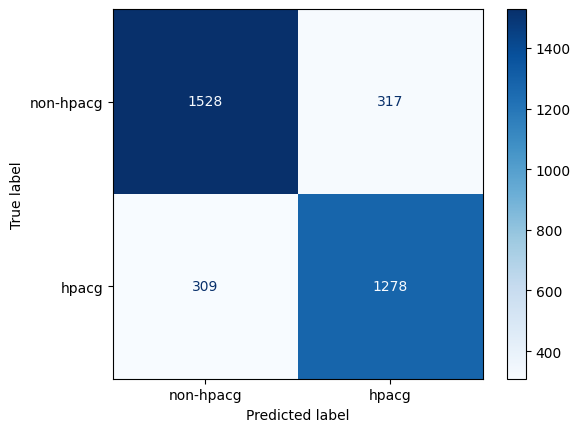

In [17]:
labels = ['non-hpacg', 'hpacg']
disp = ConfusionMatrixDisplay(confusion_matrix=linprobe_eval_metrics['lin_confusion_matrix'],display_labels=labels)
disp.plot(cmap='Blues')
# 设置纵坐标标签为垂直
TN, FP, FN, TP = confusion_matrix=linprobe_eval_metrics['lin_confusion_matrix'].ravel()
# Calculate TPR and FPR
tpr = TP / (TP + FN) if (TP + FN) > 0 else 0
fpr = FP / (FP + TN) if (FP + TN) > 0 else 0
specificity = TN / (TN + FP) if (FP + TN) > 0 else 0
Balanced_Accuracy = (specificity + tpr) / 2
Precision = TP  / (TP + FP) if (TP + FP) > 0 else 0
Weight_F1 = ((Precision * tpr) / (Precision + tpr))*2

print(f"True Positive Rate (Sensitivity,recall): [{tpr:.3f}]")
print(f"False Positive Rate : [{fpr:.3f}]")
print(f"Specificity : [{specificity:.3f}]")
print(f"Balanced Accuracy : [{Balanced_Accuracy:.3f}]")
print(f"Precision: [{Precision:.3f}]")


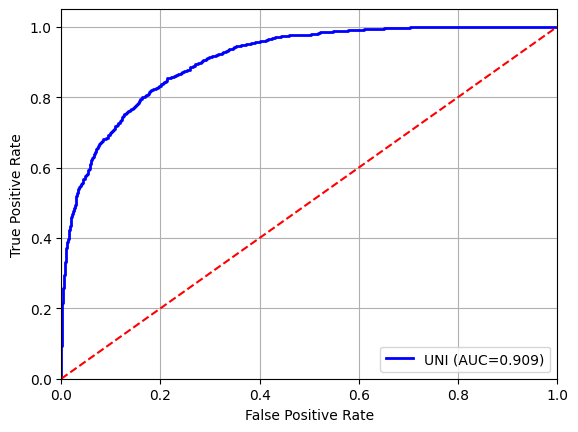

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# 假设你有以下真实标签和预测概率
true_labels = linprobe_dump['targets_all']  # 示例真实标签
pred_probs = linprobe_dump['probs_all']  # 示例预测概率

# 计算ROC曲线
fpr, tpr, thresholds = roc_curve(true_labels, pred_probs)
roc_auc = auc(fpr, tpr)

# 绘制ROC曲线
plt.figure()
plt.plot(fpr, tpr, color='blue', lw=2, label=f'UNI (AUC={roc_auc:.3f})')
plt.plot([0, 1], [0, 1], color='red', linestyle='--')  # 参考线
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc="lower right")
plt.grid()
plt.show()

visualization the wrong predict TLS pics

In [ ]:
pred_labels = linprobe_dump['preds_all']
true_labels = linprobe_dump['targets_all']
print(true_labels)

different_indices = np.where(pred_labels != true_labels)[0]
print("wrong predict idx:", different_indices)
for index in different_indices:
    predicted_value = "HP" if pred_labels[index] == 1 else "NonHP"
    true_value = "HP" if true_labels[index] == 1 else "NonHP"
    print(f"idx {index}: predict = {predicted_value}, ground_truth = {true_value}")


[0 0 0 ... 1 1 1]
wrong predict idx: [   6   17   22   32   41   45   48   55   64   76   82   92   95  100
  105  116  117  118  123  128  130  134  141  152  154  158  161  162
  165  171  178  195  197  198  199  217  227  229  231  233  235  241
  259  266  267  291  301  309  314  315  318  319  321  327  328  331
  342  343  353  355  362  364  366  376  378  379  387  397  405  410
  418  434  450  457  459  460  475  476  485  486  489  490  497  500
  504  517  520  527  533  542  543  544  547  553  558  559  562  567
  569  572  574  580  584  587  588  603  605  609  610  613  616  617
  618  633  634  635  636  638  640  646  647  649  653  654  656  657
  670  671  673  678  687  692  694  696  697  698  700  702  725  726
  728  730  754  755  757  759  761  777  786  797  799  806  808  811
  823  824  825  829  833  845  849  853  858  859  861  863  872  877
  896  902  903  905  909  912  913  915  921  923  935  939  943  949
  959  961  965  970  972  975  976  977

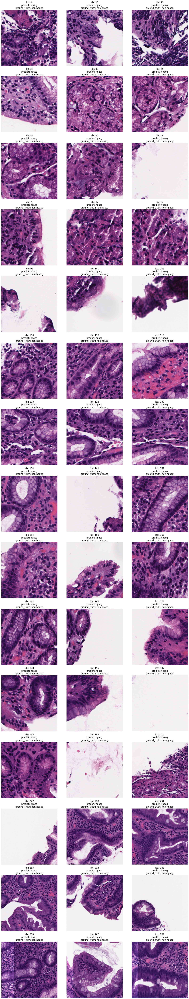

In [ ]:
# 限制只显示前 45 个不同的样本
max_show = 45
different_indices = different_indices[:max_show]  # 只取前30个

num_differences = len(different_indices)
cols = 3
rows = num_differences // cols + (num_differences % cols > 0)

plt.figure(figsize=(15, rows * 5))

# 加载所有测试图像（保持原逻辑）
images = []
for data, labels in test_dataloader:
    images.append(data)
images = torch.cat(images)

# 反标准化参数（虽然你注释掉了反标准化，但保留以备需要）
mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1)
std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1)

for i, index in enumerate(different_indices):
    plt.subplot(rows, cols, i + 1)
    
    # 获取图像（注意：images 是按 DataLoader 顺序拼接的，index 必须是全局索引）
    img = images[index]
    
    # 如果你的图像被标准化了，取消下面这行的注释来反标准化
    # img = img * std + mean
    
    img = img.clamp(0, 1)  # 确保像素值在 [0, 1] 范围内
    img = img.squeeze(0).permute(1, 2, 0).numpy()

    predicted_value = 'hpacg' if pred_labels[index] == 1 else 'non-hpacg'
    true_value = 'hpacg' if true_labels[index] == 1 else 'non-hpacg'

    plt.imshow(img)
    plt.title(f"idx: {index.item()}\npredict: {predicted_value}\nground_truth: {true_value}")
    plt.axis('off')

plt.tight_layout()
plt.show()

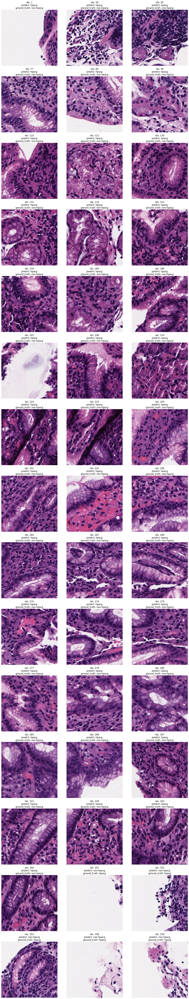

In [ ]:
num_differences = len(different_indices)
cols = 3
rows = num_differences // cols + (num_differences % cols > 0)

plt.figure(figsize=(15, rows * 5))

images = []
for data, labels in test_dataloader:
    images.append(data)

images = torch.cat(images)

mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1)
std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1)

for i, index in enumerate(different_indices):
    plt.subplot(rows, cols, i + 1)
    
    # 反标准化
    img = images[index]#  * std + mean
    img = img.clamp(0, 1)  # 限制值在 [0, 1] 之间
    img = img.squeeze(0).permute(1, 2, 0).numpy()  # 移除批量维度并变换为 (H, W, C)

    predicted_value = 'hpacg' if pred_labels[index] == 1 else 'non-hpacg'
    true_value = 'hpacg' if true_labels[index] == 1 else 'non-hpacg'

    plt.imshow(img)
    plt.title(f"idx: {index.item()}\npredict: {predicted_value}\nground_truth: {true_value}")
    plt.axis('off')  # 关闭坐标轴

plt.tight_layout()  # 自动调整子图参数
plt.show()  # 显示图形